In [1]:
import torch
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import os
import json
from sklearn.model_selection import train_test_split
import shutil
import cv2
import math

In [2]:
augmented_df = pd.read_csv("/home/Special_Problem/yolo_dataset_version_2/preprocessed/augmented_preprocessed.csv")

In [3]:
augmented_df.head()

,file,class_id,x_min,y_min,bbox_width,bbox_height,image_path
0,LS-155.jpg,1,160.001632,745.999182,93.998720,76.000284,/home/Special_Problem/yolo_dataset_version_1/i...
1,LS-155.jpg,1,53.999856,669.000342,63.001376,48.999828,/home/Special_Problem/yolo_dataset_version_1/i...
2,LS-155.jpg,1,23.999936,619.999476,70.999296,58.999920,/home/Special_Problem/yolo_dataset_version_1/i...
3,LS-155.jpg,1,208.998928,651.999978,73.000320,73.999020,/home/Special_Problem/yolo_dataset_version_1/i...
4,LS-155.jpg,1,275.000296,672.999756,64.999312,67.000824,/home/Special_Problem/yolo_dataset_version_1/i...


In [12]:
combined_df = (
    augmented_df.groupby(["file", "image_path"])
    .agg({
        "class_id": list,
        "x_min": list,
        "y_min": list,
        "bbox_width": list,
        "bbox_height": list
    })
    .reset_index()
)

In [19]:
def visualization(bboxes, labels, ax):
    for box, label in zip(bboxes, labels):
        # x_min, y_min, box_width, box_height = map(int, box)
        x_min, y_min, box_width, box_height = box
        if label == 1:
            rect = plt.Rectangle(
            ( x_min, y_min),
                box_width, box_height,
                linewidth=.2, edgecolor="blue", facecolor="none"
            )
        else:
            rect = plt.Rectangle(
            ( x_min, y_min),
                box_width, box_height,
                linewidth=.5, edgecolor="red", facecolor="none"
            )
        ax.add_patch(rect)
        ax.text(
            x_min, y_min - 5, label,
            color="blue", fontsize=2, weight="bold"
        )

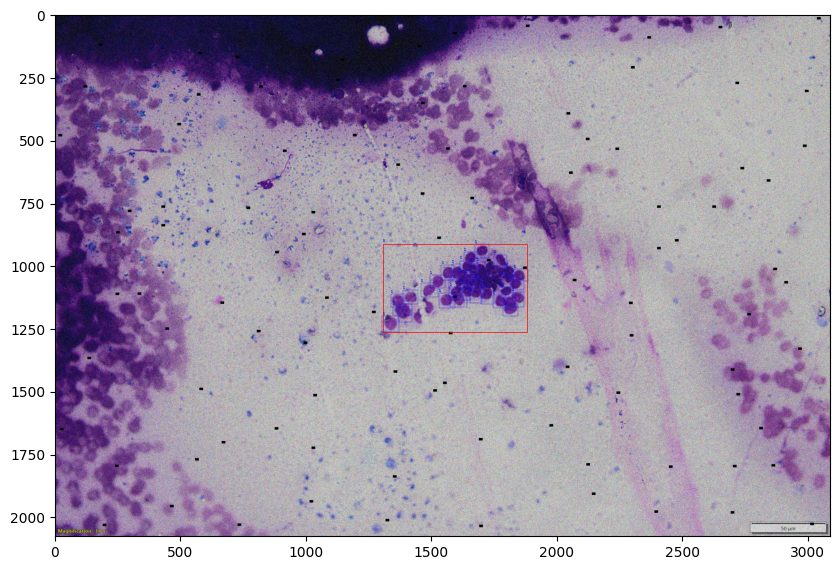

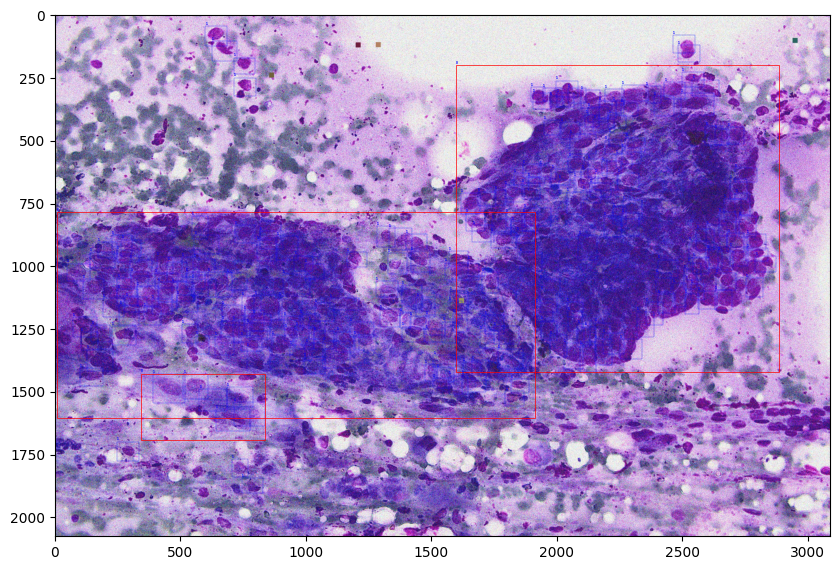

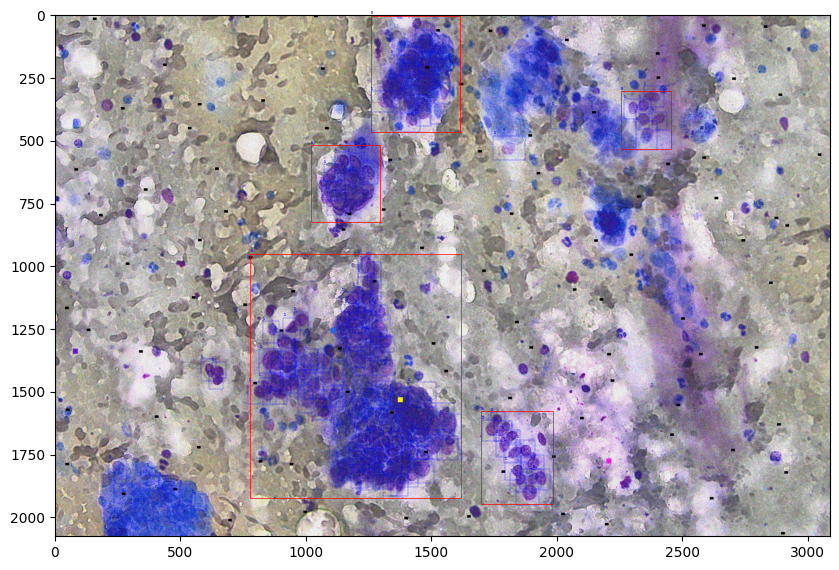

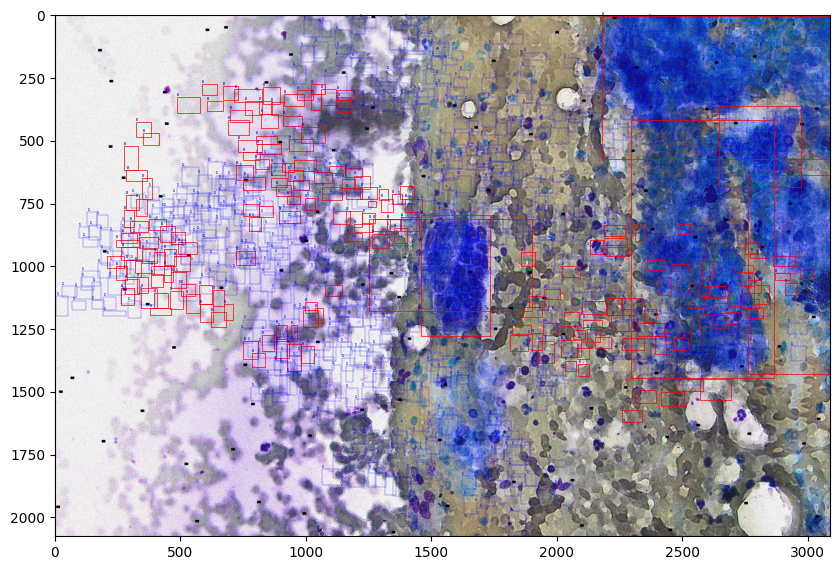

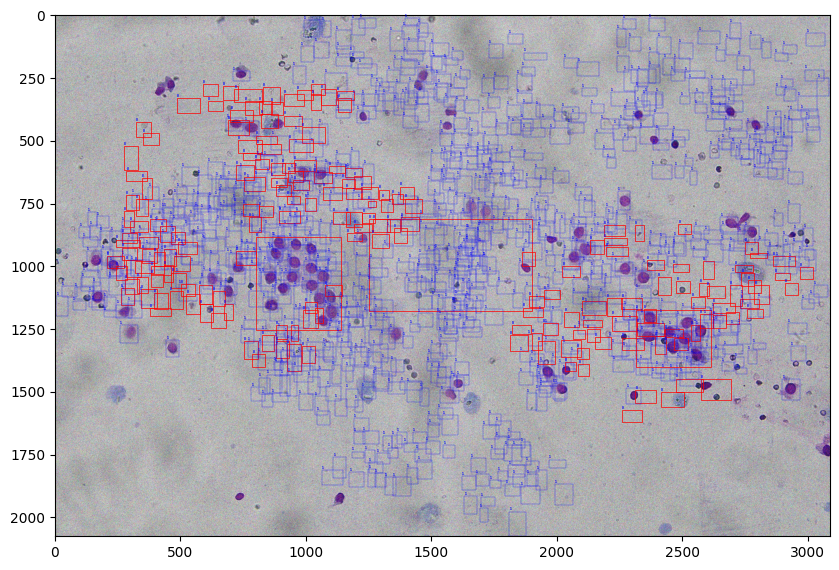

...

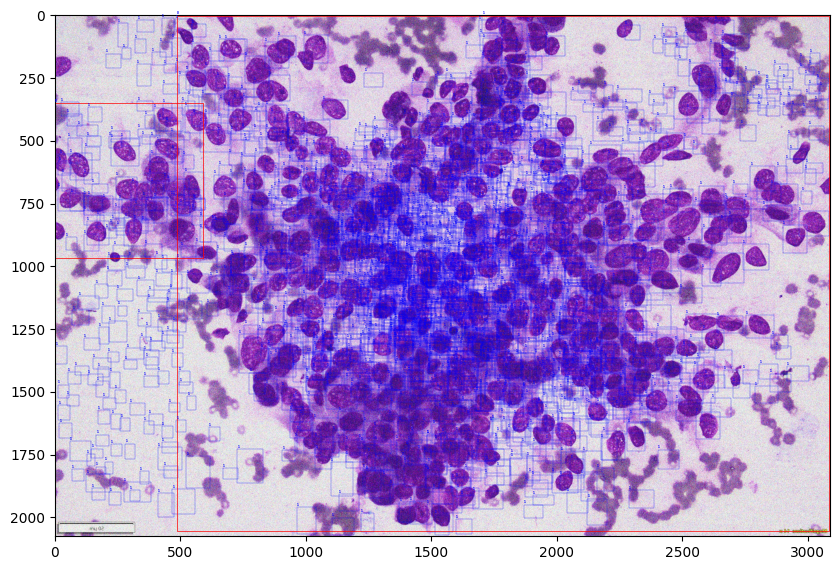

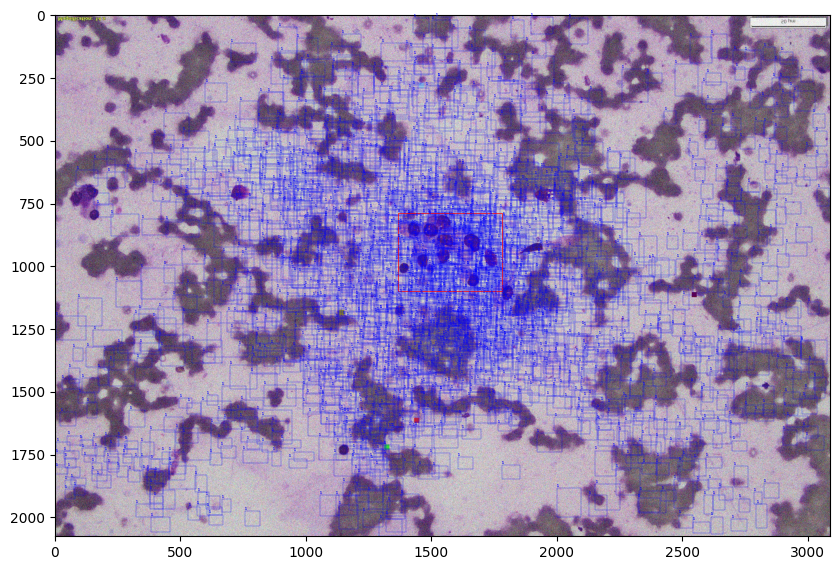

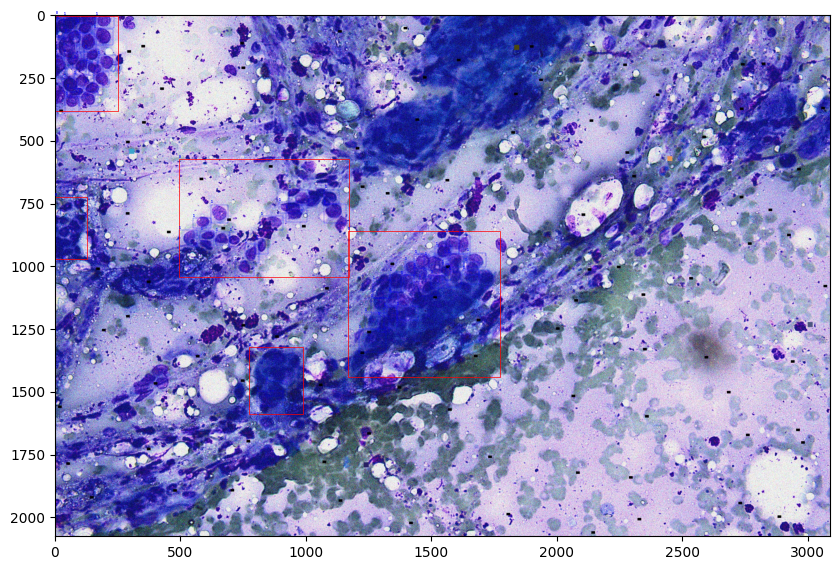

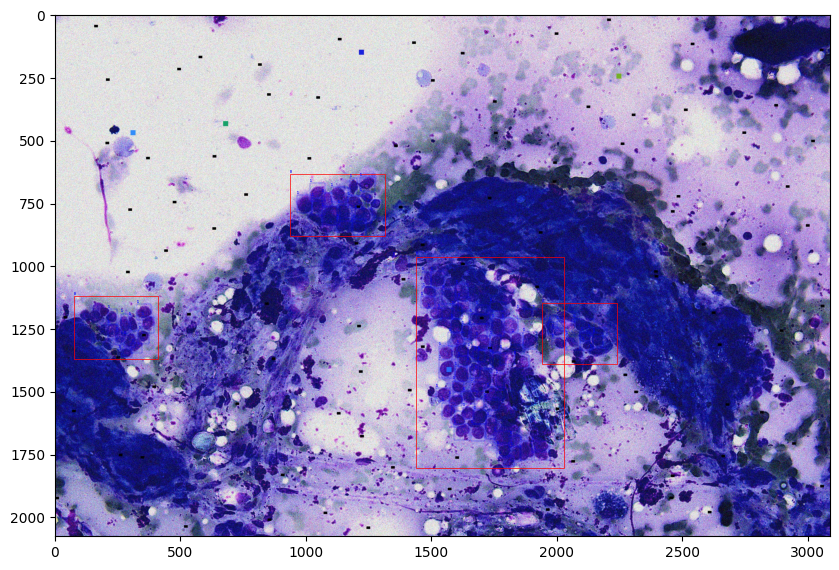

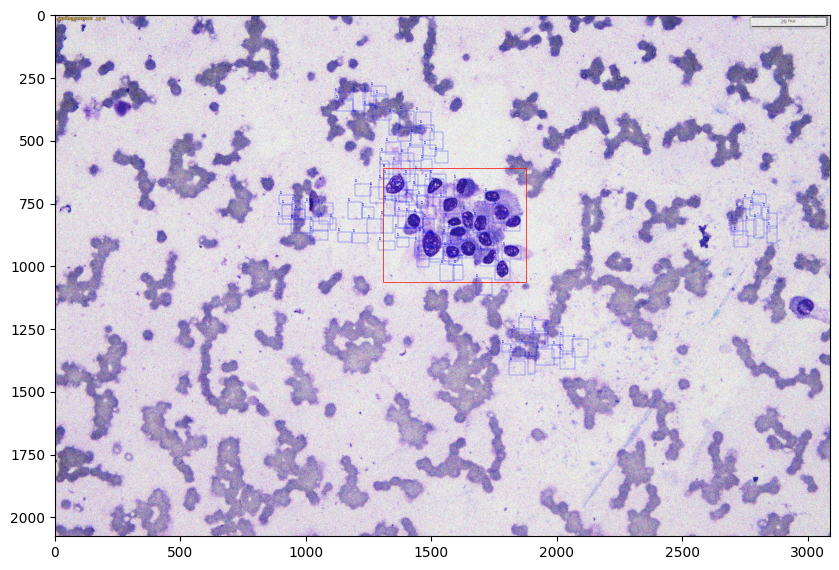

KeyboardInterrupt: 

In [ ]:
for _, group in combined_df.iterrows():
    bboxes = list(zip(group["x_min"], group["y_min"], group["bbox_width"], group["bbox_height"]))
    labels = group["class_id"]
    augmented_image_path = group["image_path"]
    bgr_image = cv2.imread(augmented_image_path)
    rgb_image = cv2.cvtColor(bgr_image, cv2.COLOR_BGR2RGB)
    img_height, img_width, _ =  rgb_image.shape
    fig, ax = plt.subplots(1, figsize=(10, 10))
    ax.imshow(rgb_image)
    visualization(bboxes, labels, ax)
    plt.show()
    break
    